In [1]:
import pyclesperanto_prototype as cle

In [3]:
# list available devices and select a specific device with only a part of its name
devices = cle.available_device_names()
print(devices)

select = cle.select_device("RTX")

# check which device is used right now
print("in use right now: " + str(cle.get_device()))

['Intel(R) Core(TM) i9-10940X CPU @ 3.30GHz', 'Intel(R) FPGA Emulation Device', 'NVIDIA GeForce RTX 3090', 'cupy backend (experimental)']
in use right now: <NVIDIA GeForce RTX 3090 on Platform: NVIDIA CUDA (1 refs)>


In [7]:
from tkinter import filedialog
from skimage.io import imread
import os

#filename_tk = filedialog.askopenfilename()  

filename_tk = r"D:\images\tnia-python-images\\deconvolution\beads\beads in agarose stack crop.tif"
print(filename_tk)

dir_path = filename_tk
full_name = os.path.basename(dir_path)
file_name = os.path.splitext(full_name)

video = imread(dir_path)

print(video.shape)

D:\images\tnia-python-images\\deconvolution\beads\beads in agarose stack crop.tif
(238, 342, 378)


In [9]:
import numpy as np
hot_pixel_indices = np.transpose((video>700).nonzero())
print(" hot pixel indices hot_pixel_indices: " + str(hot_pixel_indices), str(video[video>700]) + str(type(hot_pixel_indices)))

 hot pixel indices hot_pixel_indices: [] []<class 'numpy.ndarray'>


In [10]:
import pandas as pd

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 150)

hot_pixel_table = pd.DataFrame({'Frame no.': hot_pixel_indices[:, 0], 'x-coordinate': hot_pixel_indices[:, 2], 'y-coordinate': hot_pixel_indices[:, 1], 'pixel value':video[video>700]})
print(hot_pixel_table.head(n=400))


Empty DataFrame
Columns: [Frame no., x-coordinate, y-coordinate, pixel value]
Index: []


In [11]:
sigma1x = 2.0
sigma1y = 2.0
sigma2x = 10
sigma2y = 10

image_difference_of_gaussian2d = cle.difference_of_gaussian(video[2], sigma1_x = sigma1x, sigma1_y = sigma1y, sigma1_z = sigma2x, sigma2_x = sigma2y)
print(image_difference_of_gaussian2d) # use difference of two gaussians to eliminate most background and increase signal to noise of bead features
print(type(image_difference_of_gaussian2d))

type
pull_OCL_Array_to_numpy= cle.pull_zyx(image_difference_of_gaussian2d) # Pull OCLarray datatype from GPU to numpy array for manipulation in CPU
print(pull_OCL_Array_to_numpy)
print(type(pull_OCL_Array_to_numpy))

[[ 0.31940842 -0.4066658  -1.0427666  ...  1.8471451   1.1362495
   0.09059143]
 [ 0.27209854 -0.12228394 -0.5329132  ...  1.2017479   0.7096443
   0.00924683]
 [ 0.20567703  0.1035614  -0.09939575 ...  0.68157196  0.34514236
  -0.08756638]
 ...
 [ 0.48806     0.2657013   0.09442902 ...  0.707386    0.4255104
   0.11445236]
 [ 0.6078453   0.1482048  -0.1537323  ...  1.0014839   0.47888565
  -0.04257202]
 [ 0.63178635 -0.08446121 -0.49799347 ...  1.3201065   0.537529
  -0.20258331]]
<class 'pyclesperanto_prototype._tier0._pycl.OCLArray'>
[[ 0.31940842 -0.4066658  -1.0427666  ...  1.8471451   1.1362495
   0.09059143]
 [ 0.27209854 -0.12228394 -0.5329132  ...  1.2017479   0.7096443
   0.00924683]
 [ 0.20567703  0.1035614  -0.09939575 ...  0.68157196  0.34514236
  -0.08756638]
 ...
 [ 0.48806     0.2657013   0.09442902 ...  0.707386    0.4255104
   0.11445236]
 [ 0.6078453   0.1482048  -0.1537323  ...  1.0014839   0.47888565
  -0.04257202]
 [ 0.63178635 -0.08446121 -0.49799347 ...  1.32010

In [18]:
from matplotlib import pyplot as plt

def open_close_cle_image_fig(image, label_image, time_ms, pixel_min, pixel_max, plot_type = 'image'):

    fig, axs = plt.subplots(1,2) 

    #timer = fig.canvas.new_timer(interval = time_ms) #creating a timer object and setting an interval of 3000 milliseconds
    #timer.add_callback(close_event)

    if plot_type == 'image':
        cle.imshow(image , min_display_intensity= pixel_min,  max_display_intensity= pixel_max, colorbar = False, plot = axs[1])
        cle.imshow(label_image, labels=True, plot = axs[0])
    elif plot_type == 'hist':
        plt.hist(image.ravel(), log=True)

    plt.show()
    #timer.start()

def open_close_image_fig(image, pixel_min, pixel_max, time_ms, plot_type = 'image'):

    fig = plt.figure()
    timer = fig.canvas.new_timer(interval = time_ms) #creating a timer object and setting an interval of 3000 milliseconds
    timer.add_callback(close_event)

    if plot_type == 'image':
        plt.imshow(image, cmap='gray', vmin = pixel_min, vmax= pixel_max)
        plt.colorbar()
    elif plot_type == 'hist':
        plt.hist(image.ravel(), log=True)

    timer.start()
    plt.show()

000000000000[[0.        0.        0.        ... 1.8471451 1.1362495 0.       ]
 [0.        0.        0.        ... 1.2017479 0.        0.       ]
 [0.        0.        0.        ... 0.        0.        0.       ]
 ...
 [0.        0.        0.        ... 0.        0.        0.       ]
 [0.        0.        0.        ... 1.0014839 0.        0.       ]
 [0.        0.        0.        ... 1.3201065 0.        0.       ]]


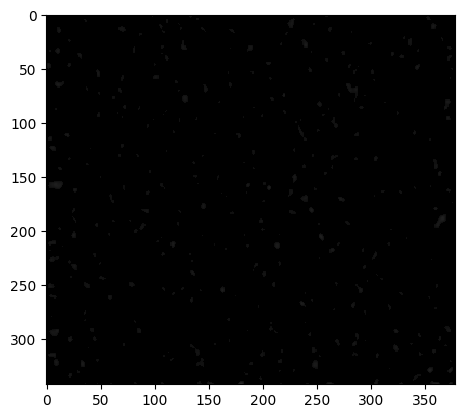

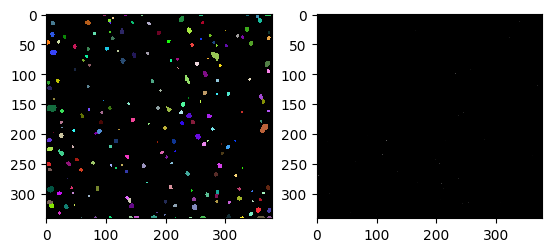

     label  original_label  bbox_min_x  bbox_min_y  bbox_min_z  bbox_max_x  bbox_max_y  bbox_max_z  bbox_width  bbox_height  bbox_depth  \
0        1               1         0.0       269.0         0.0         0.0       270.0         0.0         1.0          2.0         1.0   
1        2               2         0.0        44.0         0.0         5.0        51.0         0.0         6.0          8.0         1.0   
2        3               3         1.0       112.0         0.0         6.0       118.0         0.0         6.0          7.0         1.0   
3        4               4         1.0       248.0         0.0         7.0       254.0         0.0         7.0          7.0         1.0   
4        5               5         1.0       208.0         0.0         9.0       214.0         0.0         9.0          7.0         1.0   
5        6               6         2.0       120.0         0.0         9.0       127.0         0.0         8.0          8.0         1.0   
6        7               7 

In [19]:

pull_OCL_Array_to_numpy[pull_OCL_Array_to_numpy<1.0] = 0.0 # remove unwated low level pixels that hinder otsu labelling
push_numpy_to_OCLArray = cle.push_zyx(pull_OCL_Array_to_numpy) # push numpy array to OLCArray for GPU acceleration again
print("000000000000" + str(push_numpy_to_OCLArray))

cle.imshow(push_numpy_to_OCLArray, min_display_intensity= 0, max_display_intensity=20) # show results of noise subtraction 

image_labelled_initial = cle.voronoi_otsu_labeling(push_numpy_to_OCLArray, spot_sigma= 2.0, outline_sigma= 2.0) # label initial image frame
#image_labelled_initial = cle.eroded_otsu_labeling(image_difference_of_gaussian2d,  number_of_erosions= 2.5, outline_sigma= 8.0)
    
open_close_cle_image_fig(video[2], image_labelled_initial, 100000, 60.0, 150.0, plot_type = 'image') # show ostu labelling result comapred to RAW

import pandas as pd
stats_table = pd.DataFrame()
hot_pixel_table = pd.DataFrame()   # set up multi-frame image analysis statistics dataframe
mean_bead_intensity_per_frame = []
hot_pixel_values = []
frame = 0 
for frame in video:
    stats = 0 
    #image_difference_of_gaussian2d = cle.difference_of_gaussian(frame, sigma1_x = sigma1x, sigma1_y = sigma1y, sigma1_z = sigma2x, sigma2_x = sigma2y)
    #pull_OCL_Array_to_numpy= cle.pull_zyx(image_difference_of_gaussian2d)
    #pull_OCL_Array_to_numpy[pull_OCL_Array_to_numpy<2.0] = 0.0
    #pull_OCL_Array_to_numpy = pull_OCL_Array_to_numpy 
    #push_numpy_to_OCLArray = cle.push_zyx(pull_OCL_Array_to_numpy)
    #cle.imshow(push_numpy_to_OCLArray, min_display_intensity= 0, max_display_intensity=20)
    #image_labelled = cle.eroded_otsu_labeling(push_numpy_to_OCLArray,  number_of_erosions= 2.5, outline_sigma= 8.0) ## # for less than 25ms exposure outline sigma = 8.0 or higher, but area increase, for 50ms above outline sigma 2 is fine
    #image_labelled = cle.voronoi_otsu_labeling(push_numpy_to_OCLArray, spot_sigma= 2.0, outline_sigma= 5.0)
    #open_close_cle_image_fig(video[2], image_labelled, 100000, 60.0, 150.0, plot_type = 'image')
    stats = cle.statistics_of_labelled_pixels(frame, image_labelled_initial)  # gets stats of labelled pixels
    print(pd.DataFrame(stats))
    stats_table = pd.concat([stats_table, pd.DataFrame(stats)] , ignore_index= True) # concatenate each frame statistics to stats table
    filter_conditions = np.where((stats_table['max_intensity'] <= 700) & (stats_table['bbox_height'] >= 5.0) & (stats_table['bbox_width'] >= 5.0))
    #filter_conditions = np.where((stats_table['max_intensity'] <= 3000) & (stats_table['bbox_height'] >= 5.0) & (stats_table['bbox_width'] >= 5.0))
    filtered_stats_table = stats_table.loc[filter_conditions] # filter based on max pixel intensity and box size criteria
    mean_bead_intensity_per_frame.append(filtered_stats_table['mean_intensity'].mean())


print("mean per frame: " + str(mean_bead_intensity_per_frame))

In [20]:
stats_table.shape

(50932, 37)

In [21]:
stats_table.head()

,label,original_label,bbox_min_x,bbox_min_y,bbox_min_z,bbox_max_x,bbox_max_y,bbox_max_z,bbox_width,bbox_height,bbox_depth,min_intensity,max_intensity,sum_intensity,area,mean_intensity,sum_intensity_times_x,mass_center_x,sum_intensity_times_y,mass_center_y,sum_intensity_times_z,mass_center_z,sum_x,centroid_x,sum_y,centroid_y,sum_z,centroid_z,sum_distance_to_centroid,mean_distance_to_centroid,sum_distance_to_mass_center,mean_distance_to_mass_center,standard_deviation_intensity,max_distance_to_centroid,max_distance_to_mass_center,mean_max_distance_to_centroid_ratio,mean_max_distance_to_mass_center_ratio
0,1,1,0.0,269.0,0.0,0.0,270.0,0.0,1.0,2.0,1.0,48.0,51.0,99.0,2.0,49.500000,0.0,0.000000,26679.0,269.484863,0.0,0.0,0.0,0.000000,539.0,269.500000,0.0,0.0,1.000000,0.500000,1.000000,0.500000,1.500000,0.500000,0.515137,1.000000,1.030274
1,2,2,0.0,44.0,0.0,5.0,51.0,0.0,6.0,8.0,1.0,24.0,46.0,1511.0,41.0,36.853657,3610.0,2.389146,71415.0,47.263401,0.0,0.0,100.0,2.439024,1938.0,47.268291,0.0,0.0,99.701912,2.431754,99.713463,2.432036,4.708896,3.773638,3.786201,1.551817,1.556803
2,3,3,1.0,112.0,0.0,6.0,118.0,0.0,6.0,7.0,1.0,33.0,47.0,1308.0,34.0,38.470589,4580.0,3.501529,150069.0,114.731659,0.0,0.0,119.0,3.500000,3900.0,114.705879,0.0,0.0,74.544189,2.192476,74.546471,2.192543,3.582927,3.331851,3.306597,1.519675,1.508110
3,4,4,1.0,248.0,0.0,7.0,254.0,0.0,7.0,7.0,1.0,28.0,51.0,1678.0,41.0,40.926826,6708.0,3.997616,421032.0,250.912994,0.0,0.0,165.0,4.024390,10286.0,250.878036,0.0,0.0,98.602264,2.404933,98.582535,2.404452,4.979912,3.654721,3.656488,1.519677,1.520716
4,5,5,1.0,208.0,0.0,9.0,214.0,0.0,9.0,7.0,1.0,28.0,52.0,2177.0,55.0,39.581818,10880.0,4.997703,459365.0,211.008255,0.0,0.0,275.0,5.000000,11605.0,211.000000,0.0,0.0,154.923706,2.816795,154.932709,2.816958,4.788968,4.472136,4.477887,1.587668,1.589618


In [22]:
filter_conditions = np.where((stats_table['max_intensity'] <= 700) & (stats_table['bbox_height'] >= 5.0) & (stats_table['bbox_width'] >= 5.0))
#filter_conditions = np.where((stats_table['max_intensity'] <= 3000) & (stats_table['bbox_height'] >= 5.0) & (stats_table['bbox_width'] >= 5.0)) # 1000ms needs high max threshold
filtered_columns = ["label", "bbox_height", "bbox_width","max_intensity", "mean_intensity","centroid_x","centroid_y"]

filtered_stats_table = stats_table[filtered_columns].loc[filter_conditions]

In [23]:
filtered_stats_table.head()

,label,bbox_height,bbox_width,max_intensity,mean_intensity,centroid_x,centroid_y
1,2,8.0,6.0,46.0,36.853657,2.439024,47.268291
2,3,7.0,6.0,47.0,38.470589,3.500000,114.705879
3,4,7.0,7.0,51.0,40.926826,4.024390,250.878036
4,5,7.0,9.0,52.0,39.581818,5.000000,211.000000
5,6,8.0,8.0,50.0,38.387753,5.816327,123.571426


In [24]:
filtered_stats_table.shape

(32130, 7)

In [26]:
average_bead_intensity_across_frames = filtered_stats_table['mean_intensity'].mean()  # calcualte total bead men intensity across all frames
print(" average bead intensity " + str(average_bead_intensity_across_frames))

 average bead intensity 40.156517
